This step focuses on EDA analysis for the data. The goal of the EDA work is to
get familiar with the features in our dataset, investigate the relationships between
features, and generally understand the core characteristics of the dataset. 

**Cleaning, transforming, and visualizing**

Visualizing correlations

**_Importing libraries_**

In [1]:
import os
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns # For all our visualization needs.
import statsmodels.api as sm # What does this do? Find out and type here. A convenience interface for specifying models using formula strings and DataFrames. 
from statsmodels.graphics.api import abline_plot # What does this do? Find out and type here. 
from sklearn.metrics import mean_squared_error, r2_score # What does this do? Find out and type here.
from sklearn.model_selection import train_test_split #  What does this do? Find out and type here.
from sklearn import linear_model, preprocessing # What does this do? Find out and type here.
import warnings # For handling error messages.
# Don't worry about the following two instructions: they just suppress warnings that could occur later. 
warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.filterwarnings(action="ignore", module="scipy", message="^internal gelsd")

**_Loading Appliances Energy Usage Data_**

In [2]:
appliances_data = pd.read_csv('C:/Users/msale/Documents/Springboard Data Science Track_Jan 2022/Springboard-Capstone-Two/raw_data/energydata.csv')

_Data Science Problem_

The purpose of this data science project is to come up with a model to predict the applainces energy usage based on consumner's house temperature and humidity conditions plus outside enviromental conditions 

In [3]:
appliances_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   date         19735 non-null  object 
 1   Appliances   19735 non-null  int64  
 2   lights       19735 non-null  int64  
 3   T1           19735 non-null  float64
 4   RH_1         19735 non-null  float64
 5   T2           19735 non-null  float64
 6   RH_2         19735 non-null  float64
 7   T3           19735 non-null  float64
 8   RH_3         19735 non-null  float64
 9   T4           19735 non-null  float64
 10  RH_4         19735 non-null  float64
 11  T5           19735 non-null  float64
 12  RH_5         19735 non-null  float64
 13  T6           19735 non-null  float64
 14  RH_6         19735 non-null  float64
 15  T7           19735 non-null  float64
 16  RH_7         19735 non-null  float64
 17  T8           19735 non-null  float64
 18  RH_8         19735 non-null  float64
 19  T9  

In [4]:
appliances_data.head()

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [5]:
appliances_data.isnull().values.any()

False

**_This is a data set with no missing data_ :)**

**_Rename columns for more readability_**

In [6]:
appliances_data= appliances_data.rename(index=str, columns={"Appliances":"Appliances_E_Wh", "lights": "Lights_E_Wh","T1":"T_Kitchen", "RH_1":"H_Kitchen", "T2":"T_Living", "RH_2":"H_Living", "T3":"T_Laundry", "RH_3":"H_Laundry", "T4":"T_Office", "RH_4":"H_Office", "T5":"T_Bathroom", "RH_5":"H_Bathroom", "T6":"T_Building_out_NS", "RH_6":"H_Building_out_NS",
"T7":"T_Ironning", "RH_7":"H_Ironing", "T8":"T_Teenager", "RH_8":"H_Teenager", "T9":"T_Parents", "RH_9":"H_Parents", "Press_mm_hg": "Press_out", "RH_out":"H_out", "rv1":"RV_1", "rv2": "RV_2"})

In [7]:
appliances_data.head()

,date,Appliances_E_Wh,Lights_E_Wh,T_Kitchen,H_Kitchen,T_Living,H_Living,T_Laundry,H_Laundry,T_Office,...,T_Parents,H_Parents,T_out,Press_out,H_out,Windspeed,Visibility,Tdewpoint,RV_1,RV_2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668
3,2016-01-11 17:30:00,50,40,19.89,46.066667,19.2,44.590000,19.79,45.000000,18.890000,...,17.000000,45.40,6.250000,733.8,92.0,6.000000,51.500000,5.0,45.410389,45.410389
4,2016-01-11 17:40:00,60,40,19.89,46.333333,19.2,44.530000,19.79,45.000000,18.890000,...,17.000000,45.40,6.133333,733.9,92.0,5.666667,47.666667,4.9,10.084097,10.084097


In [8]:
appliances_data.describe().T

,count,mean,std,min,25%,50%,75%,max
Appliances_E_Wh,19735.0,97.694958,102.524891,10.000000,50.000000,60.000000,100.000000,1080.000000
Lights_E_Wh,19735.0,3.801875,7.935988,0.000000,0.000000,0.000000,0.000000,70.000000
T_Kitchen,19735.0,21.686571,1.606066,16.790000,20.760000,21.600000,22.600000,26.260000
H_Kitchen,19735.0,40.259739,3.979299,27.023333,37.333333,39.656667,43.066667,63.360000
T_Living,19735.0,20.341219,2.192974,16.100000,18.790000,20.000000,21.500000,29.856667
H_Living,19735.0,40.420420,4.069813,20.463333,37.900000,40.500000,43.260000,56.026667
T_Laundry,19735.0,22.267611,2.006111,17.200000,20.790000,22.100000,23.290000,29.236000
H_Laundry,19735.0,39.242500,3.254576,28.766667,36.900000,38.530000,41.760000,50.163333
T_Office,19735.0,20.855335,2.042884,15.100000,19.530000,20.666667,22.100000,26.200000
H_Office,19735.0,39.026904,4.341321,27.660000,35.530000,38.400000,42.156667,51.090000


_Appliances_E_Wh_ std is higehr than mean value! Same is true for _Lights_E_Wh_ These seem to be abnormal distributions.  

In [9]:
df = appliances_data # calling our tidy DataFrame df

In [10]:
df['Appliances_E_Wh'].describe()

count    19735.000000
mean        97.694958
std        102.524891
min         10.000000
25%         50.000000
50%         60.000000
75%        100.000000
max       1080.000000
Name: Appliances_E_Wh, dtype: float64

In [11]:
df['Appliances_E_Wh'].value_counts()

50      4368
60      3282
40      2019
70      1560
80      1205
        ... 
890        1
1070       1
910        1
1080       1
840        1
Name: Appliances_E_Wh, Length: 92, dtype: int64

In [12]:
df['Lights_E_Wh'].describe()

count    19735.000000
mean         3.801875
std          7.935988
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max         70.000000
Name: Lights_E_Wh, dtype: float64

In [13]:
df['Lights_E_Wh'].value_counts()

0     15252
10     2212
20     1624
30      559
40       77
50        9
70        1
60        1
Name: Lights_E_Wh, dtype: int64

**_Generating histograms of the numeric columns_**

In [14]:
df= df.drop(["RV_1", "RV_2"],axis=1)  # dropping two random variables 

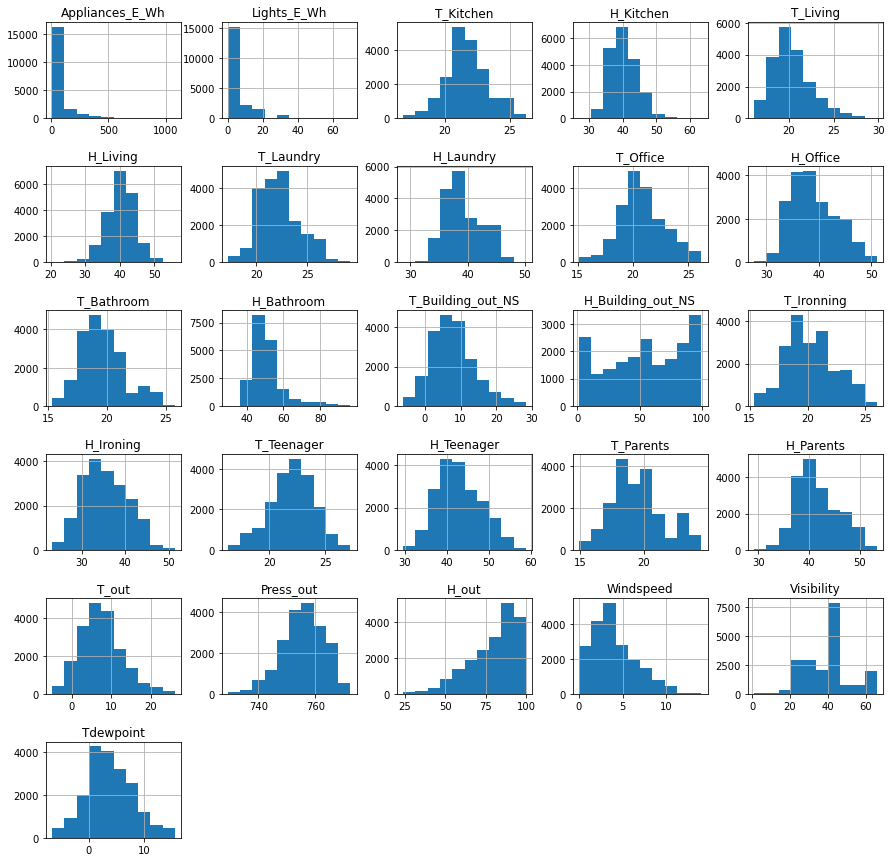

In [15]:
df.hist(figsize=(15,15))
plt.subplots_adjust(hspace=0.5);

_**Appliances_E_Wh & Lights_E_Wh_** are heavily skewed to the left. **H_Building_out_NS** has a strange distribution and that for **H_out** is skewed to the right. _Visibility_ also looks abnormal. 

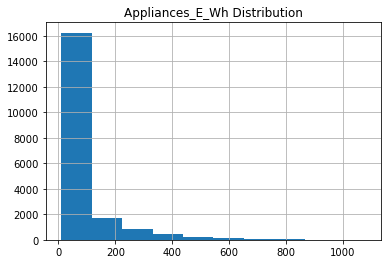

In [16]:
df['Appliances_E_Wh'].hist() 
plt.title("Appliances_E_Wh Distribution")
plt.subplots_adjust(hspace=0.5);

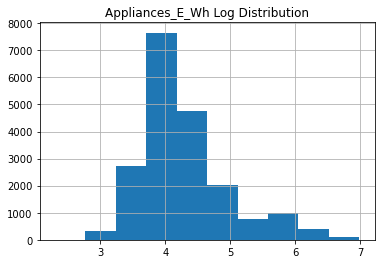

In [20]:
np.log(df['Appliances_E_Wh']).hist()  # log transformation makes the hist plot more appealing and normal
plt.title("Appliances_E_Wh Log Distribution")
plt.subplots_adjust(hspace=0.5);

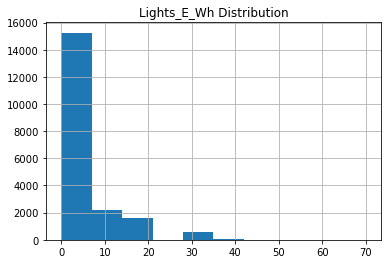

In [18]:
df['Lights_E_Wh'].hist()
plt.title("Lights_E_Wh Distribution")
plt.subplots_adjust(hspace=0.5);

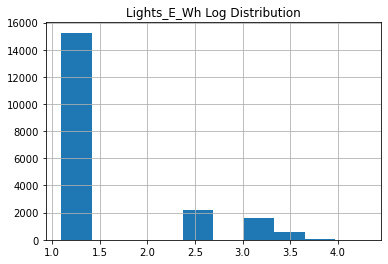

In [22]:
df['Lights_E_Wh'] = df['Lights_E_Wh'] + 1
np.log(df['Lights_E_Wh']).hist()
plt.title("Lights_E_Wh Log Distribution")
plt.subplots_adjust(hspace=0.5);

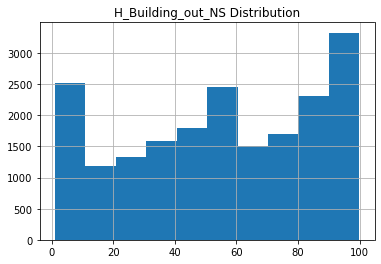

In [23]:
df['H_Building_out_NS'].hist()
plt.title("H_Building_out_NS Distribution")
plt.subplots_adjust(hspace=0.5);

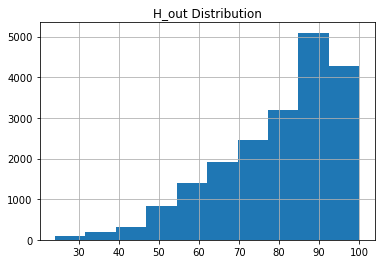

In [24]:
df['H_out'].hist();
plt.title("H_out Distribution");

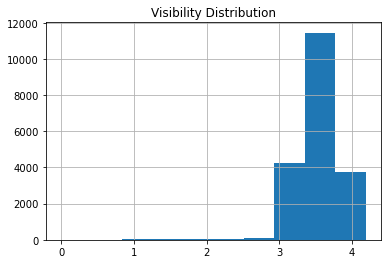

In [25]:
np.log(df['Visibility']).hist()   
plt.title("Visibility Distribution");
plt.subplots_adjust(hspace=0.5);

In [26]:
df.corr()  # Correlation matrix 

,Appliances_E_Wh,Lights_E_Wh,T_Kitchen,H_Kitchen,T_Living,H_Living,T_Laundry,H_Laundry,T_Office,H_Office,...,T_Teenager,H_Teenager,T_Parents,H_Parents,T_out,Press_out,H_out,Windspeed,Visibility,Tdewpoint
Appliances_E_Wh,1.000000,0.197278,0.055447,0.086031,0.120073,-0.060465,0.085060,0.036292,0.040281,0.016965,...,0.039572,-0.094039,0.010010,-0.051462,0.099155,-0.034885,-0.152282,0.087122,0.000230,0.015353
Lights_E_Wh,0.197278,1.000000,-0.023528,0.106968,-0.005622,0.050985,-0.097393,0.131161,-0.008859,0.114936,...,-0.071458,0.012915,-0.157592,-0.008766,-0.074424,-0.010576,0.068543,0.060281,0.020038,-0.036322
T_Kitchen,0.055447,-0.023528,1.000000,0.164006,0.836834,-0.002509,0.892402,-0.028550,0.877001,0.097861,...,0.825413,-0.006441,0.844777,0.071756,0.682846,-0.150574,-0.345481,-0.087654,-0.076210,0.571309
H_Kitchen,0.086031,0.106968,0.164006,1.000000,0.269839,0.797535,0.253230,0.844677,0.106180,0.880359,...,-0.030053,0.736196,0.115263,0.764001,0.340767,-0.293957,0.274126,0.204932,-0.021057,0.639106
T_Living,0.120073,-0.005622,0.836834,0.269839,1.000000,-0.165610,0.735245,0.121497,0.762066,0.231563,...,0.578191,0.068534,0.675535,0.157346,0.792255,-0.133028,-0.505291,0.052495,-0.069721,0.582602
H_Living,-0.060465,0.050985,-0.002509,0.797535,-0.165610,1.000000,0.137319,0.678326,-0.047304,0.721435,...,-0.041023,0.679777,0.054544,0.676467,0.033674,-0.255646,0.584911,0.069190,-0.005368,0.499152
T_Laundry,0.085060,-0.097393,0.892402,0.253230,0.735245,0.137319,1.000000,-0.011234,0.852778,0.122737,...,0.795283,0.044427,0.901324,0.134602,0.699417,-0.189974,-0.281718,-0.100776,-0.102310,0.645886
H_Laundry,0.036292,0.131161,-0.028550,0.844677,0.121497,0.678326,-0.011234,1.000000,-0.140457,0.898978,...,-0.283228,0.828822,-0.195270,0.833538,0.118207,-0.233274,0.356192,0.263188,0.017041,0.414387
T_Office,0.040281,-0.008859,0.877001,0.106180,0.762066,-0.047304,0.852778,-0.140457,1.000000,-0.048650,...,0.796256,-0.095192,0.889439,-0.025549,0.663478,-0.075292,-0.388602,-0.185747,-0.104768,0.519471
H_Office,0.016965,0.114936,0.097861,0.880359,0.231563,0.721435,0.122737,0.898978,-0.048650,1.000000,...,-0.167066,0.847259,-0.044518,0.856591,0.293289,-0.250748,0.336813,0.300192,0.002636,0.616509


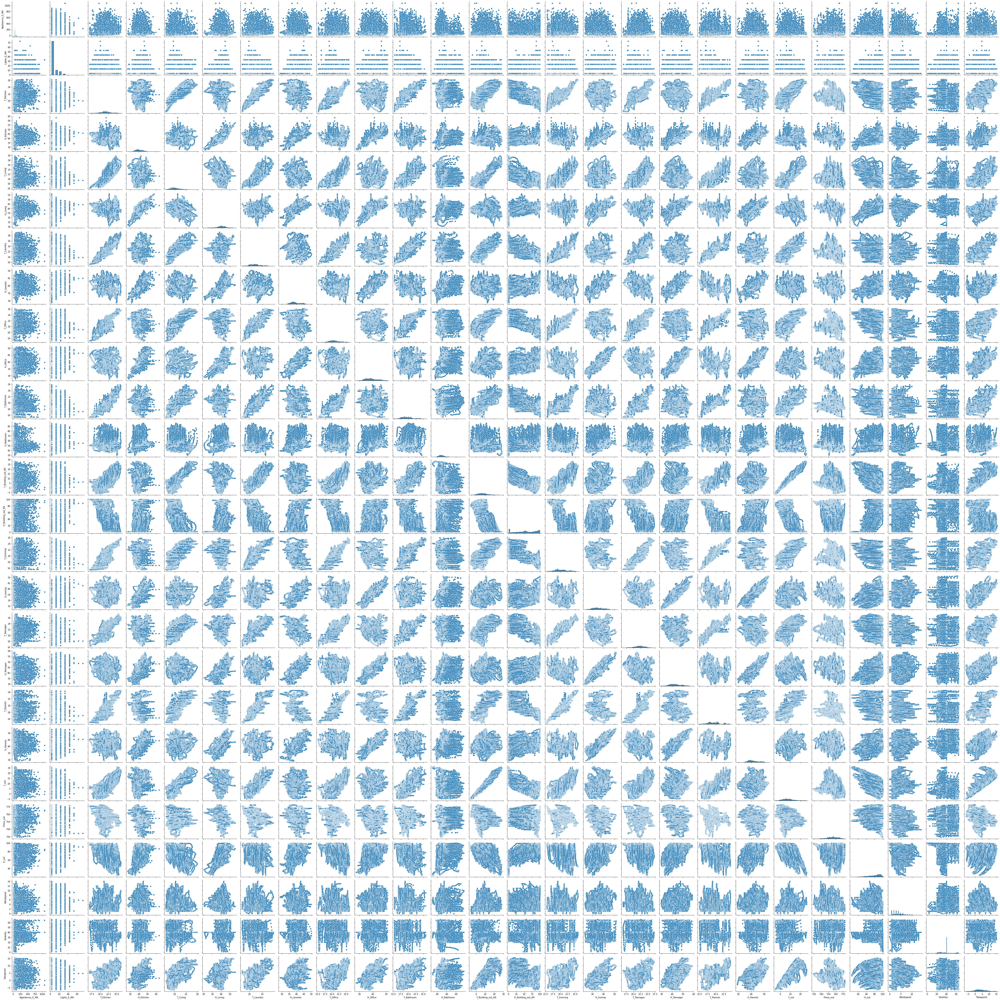

In [27]:
sns.pairplot(df);  

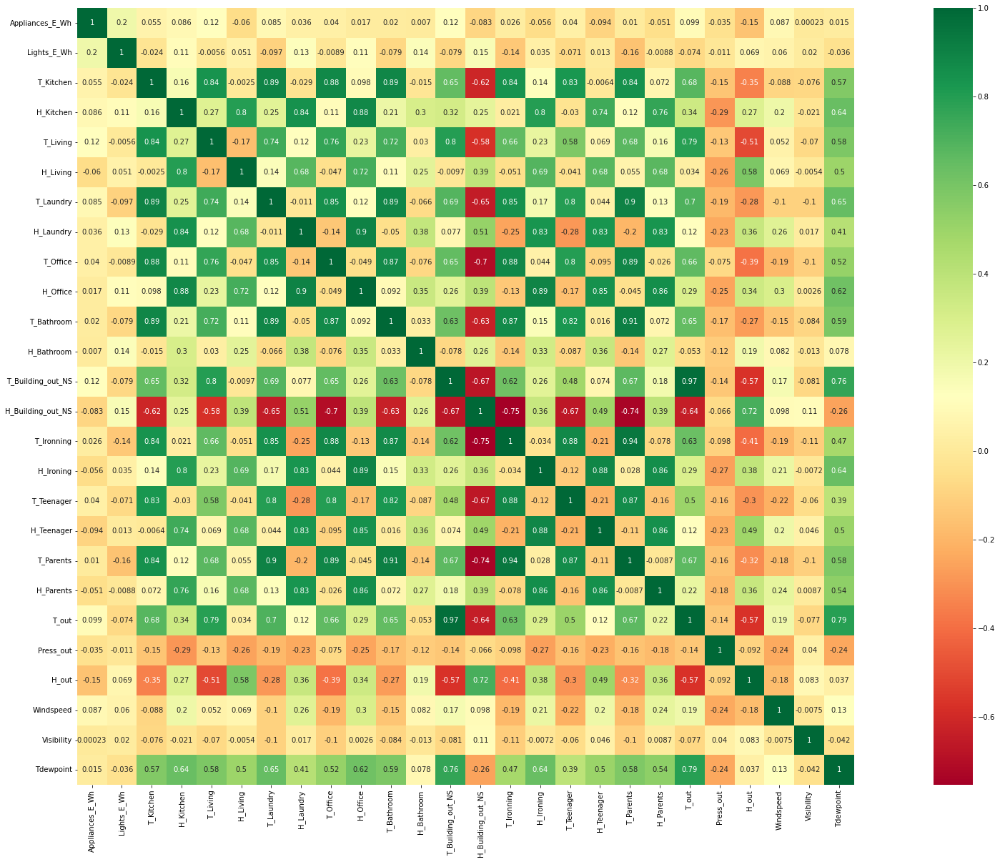

In [28]:
plt.figure(figsize=(40,20))

_ = sns.heatmap(df.corr(), annot=True, square=True, cmap='RdYlGn');

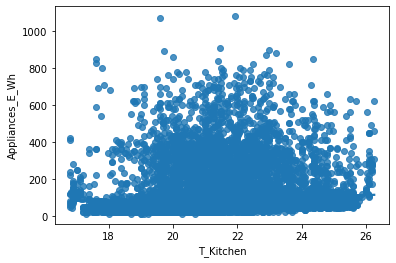

In [29]:
sns.regplot(x ='T_Kitchen', y ='Appliances_E_Wh', data = df); # Kitchen temp is expected to affect the energy usage

In [30]:
df['Appliances_E_Wh'] = np.log(df['Appliances_E_Wh'])  # log transformation of Appliances_E_Wh

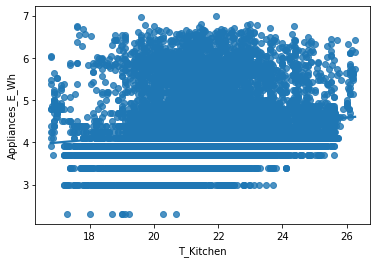

In [31]:
sns.regplot(x ='T_Kitchen', y ='Appliances_E_Wh', data = df);

In [32]:
df.corr()  # we get better coef with log transformation of Appliances_E_Wh

,Appliances_E_Wh,Lights_E_Wh,T_Kitchen,H_Kitchen,T_Living,H_Living,T_Laundry,H_Laundry,T_Office,H_Office,...,T_Teenager,H_Teenager,T_Parents,H_Parents,T_out,Press_out,H_out,Windspeed,Visibility,Tdewpoint
Appliances_E_Wh,1.000000,0.261442,0.160747,0.084457,0.214756,-0.093674,0.167221,-0.006462,0.132359,-0.006533,...,0.153917,-0.165397,0.092553,-0.115582,0.176161,-0.072632,-0.226185,0.087722,-0.010970,0.056241
Lights_E_Wh,0.261442,1.000000,-0.023528,0.106968,-0.005622,0.050985,-0.097393,0.131161,-0.008859,0.114936,...,-0.071458,0.012915,-0.157592,-0.008766,-0.074424,-0.010576,0.068543,0.060281,0.020038,-0.036322
T_Kitchen,0.160747,-0.023528,1.000000,0.164006,0.836834,-0.002509,0.892402,-0.028550,0.877001,0.097861,...,0.825413,-0.006441,0.844777,0.071756,0.682846,-0.150574,-0.345481,-0.087654,-0.076210,0.571309
H_Kitchen,0.084457,0.106968,0.164006,1.000000,0.269839,0.797535,0.253230,0.844677,0.106180,0.880359,...,-0.030053,0.736196,0.115263,0.764001,0.340767,-0.293957,0.274126,0.204932,-0.021057,0.639106
T_Living,0.214756,-0.005622,0.836834,0.269839,1.000000,-0.165610,0.735245,0.121497,0.762066,0.231563,...,0.578191,0.068534,0.675535,0.157346,0.792255,-0.133028,-0.505291,0.052495,-0.069721,0.582602
H_Living,-0.093674,0.050985,-0.002509,0.797535,-0.165610,1.000000,0.137319,0.678326,-0.047304,0.721435,...,-0.041023,0.679777,0.054544,0.676467,0.033674,-0.255646,0.584911,0.069190,-0.005368,0.499152
T_Laundry,0.167221,-0.097393,0.892402,0.253230,0.735245,0.137319,1.000000,-0.011234,0.852778,0.122737,...,0.795283,0.044427,0.901324,0.134602,0.699417,-0.189974,-0.281718,-0.100776,-0.102310,0.645886
H_Laundry,-0.006462,0.131161,-0.028550,0.844677,0.121497,0.678326,-0.011234,1.000000,-0.140457,0.898978,...,-0.283228,0.828822,-0.195270,0.833538,0.118207,-0.233274,0.356192,0.263188,0.017041,0.414387
T_Office,0.132359,-0.008859,0.877001,0.106180,0.762066,-0.047304,0.852778,-0.140457,1.000000,-0.048650,...,0.796256,-0.095192,0.889439,-0.025549,0.663478,-0.075292,-0.388602,-0.185747,-0.104768,0.519471
H_Office,-0.006533,0.114936,0.097861,0.880359,0.231563,0.721435,0.122737,0.898978,-0.048650,1.000000,...,-0.167066,0.847259,-0.044518,0.856591,0.293289,-0.250748,0.336813,0.300192,0.002636,0.616509


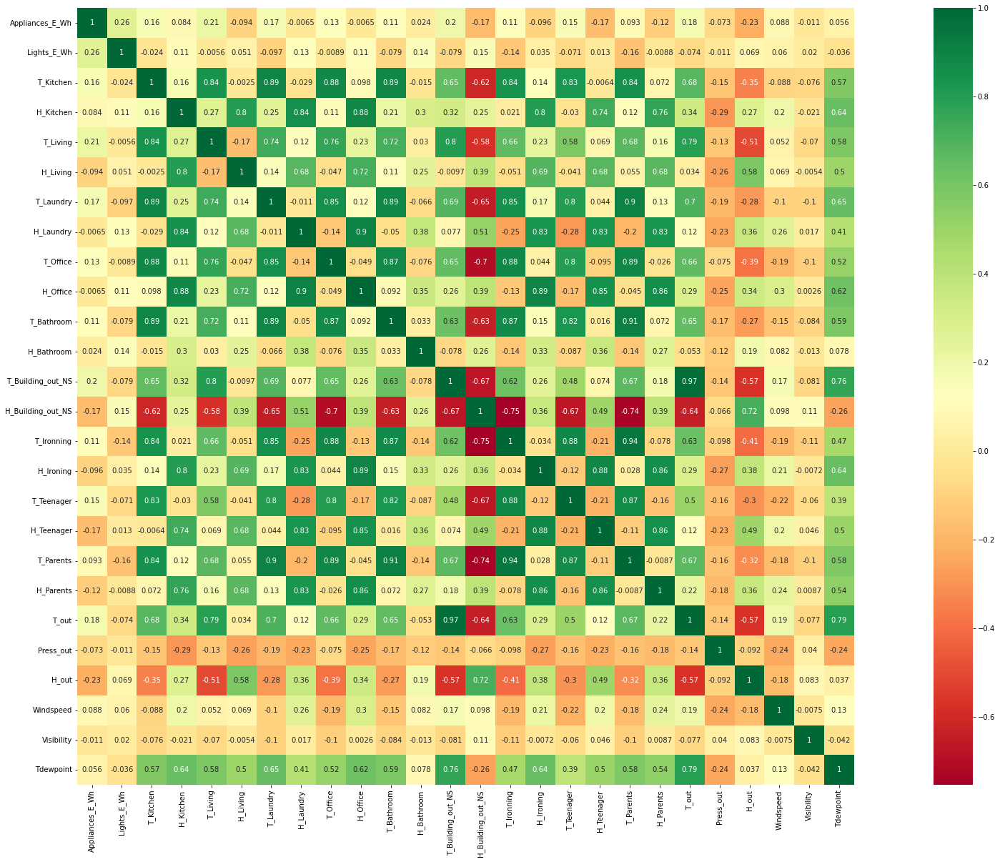

In [33]:
plt.figure(figsize=(40,20))

_ = sns.heatmap(df.corr(), annot=True, square=True, cmap='RdYlGn');

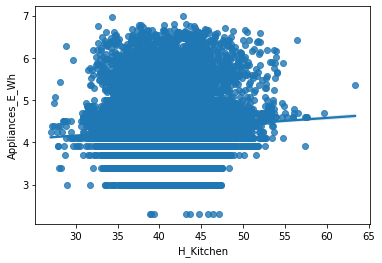

In [34]:
sns.regplot(x='H_Kitchen', y ='Appliances_E_Wh', data = df);

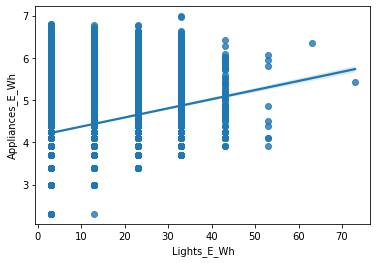

In [35]:
sns.regplot(x='Lights_E_Wh', y ='Appliances_E_Wh', data = df);

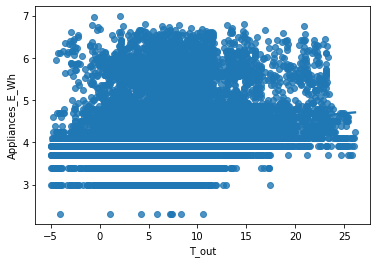

In [36]:
sns.regplot(x='T_out', y ='Appliances_E_Wh', data = df);

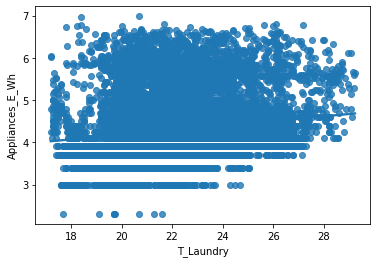

In [37]:
sns.regplot(x='T_Laundry', y ='Appliances_E_Wh', data = df);

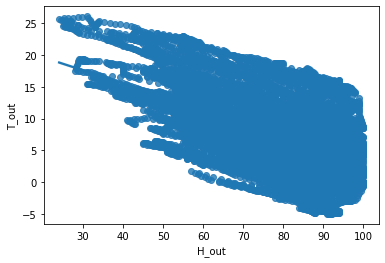

In [38]:
sns.regplot(x='H_out', y ='T_out', data = df);  # relationship of features with each other 

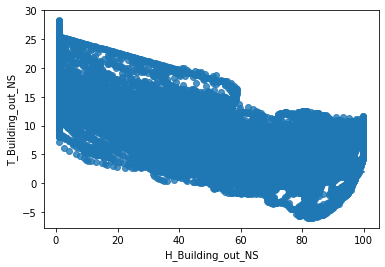

In [39]:
sns.regplot(x='H_Building_out_NS', y ='T_Building_out_NS', data = df); # relationship of features with each other 

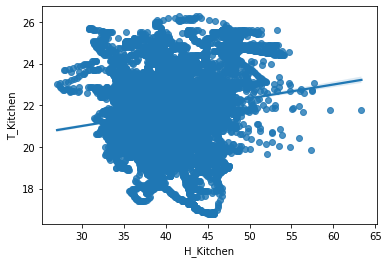

In [40]:
sns.regplot(x='H_Kitchen', y ='T_Kitchen', data = df); # relationship of features with each other 

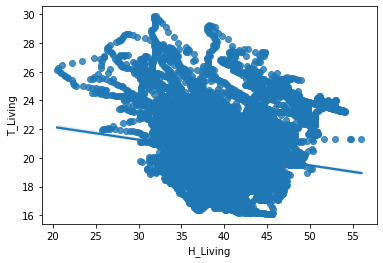

In [41]:
sns.regplot(x='H_Living', y ='T_Living', data = df); # relationship of features with each other 

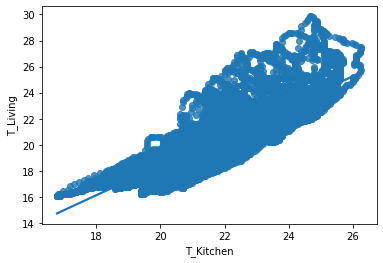

In [67]:
sns.regplot(x='T_Kitchen', y ='T_Living', data = df);

### I think more needs to be done here before we go for modeling. PCA and feature engineering for example to reduce the number of features###

### Also for the modeling part, CV needs to be done. 

**First Model**  Linear Regression 

In [42]:
y = df[['Appliances_E_Wh']]

X = df.drop(["Appliances_E_Wh", "date"],axis=1)  # considering all the variables 

In [44]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 123)

In [46]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((13814, 25), (5921, 25), (13814, 1), (5921, 1))

In [47]:
rModel1= linear_model.LinearRegression(normalize=True)

In [48]:
rModel1.fit(X_train, y_train)

LinearRegression(normalize=True)

In [49]:
rModel1.score(X_train, y_train)   # training accuracy 

0.273424148470076

In [50]:
rModel1.score(X_test, y_test) # test accuracy 

0.2757005959221984

In [51]:
rModel1.coef_

array([[ 0.01672262,  0.01927701,  0.10598849, -0.10971882, -0.08764838,
         0.15940815,  0.02779907, -0.02670796,  0.00307248,  0.00945694,
         0.00289923,  0.05178439,  0.00210574, -0.01805758, -0.00668438,
         0.09944202, -0.04580027, -0.12102232, -0.01354517, -0.07218252,
        -0.00082143, -0.00796221,  0.01293853,  0.00082875,  0.0405281 ]])

In [52]:
rModel1.intercept_

array([5.07362402])

In [53]:
y_pred = rModel1.predict(X_test)

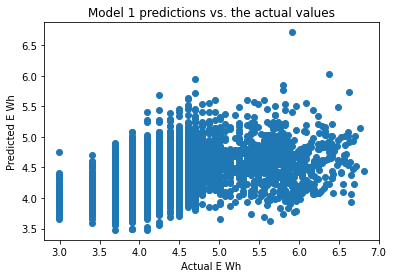

In [54]:
plt.scatter(y_test,y_pred)
plt.title("Model 1 predictions vs. the actual values")
plt.xlabel('Actual E Wh')
plt.ylabel('Predicted E Wh');

**2nd Model**  OLS

In [56]:
X = sm.add_constant(X)

In [57]:
rModel2 = sm.OLS(y_train, X_train)

In [58]:
rModel2_results = rModel2.fit()   

In [59]:
rModel2_results.summary()   # R2 improved significantly 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:        Appliances_E_Wh   R-squared (uncentered):                   0.983
Model:                            OLS   Adj. R-squared (uncentered):              0.983
Method:                 Least Squares   F-statistic:                          3.263e+04
Date:                Thu, 10 Mar 2022   Prob (F-statistic):                        0.00
Time:                        17:45:40   Log-Likelihood:                         -11634.
No. Observations:               13814   AIC:                                  2.332e+04
Df Residuals:                   13789   BIC:                                  2.351e+04
Df Model:                          25                                                  
Covariance Type:            nonrobust                                                  
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Lights_E_Wh           0.0167      0.001     24.357      0.000       0.015       0.018
T_Kitchen             0.0179      0.013      1.346      0.178      -0.008       0.044
H_Kitchen             0.1077      0.005     22.320      0.000       0.098       0.117
T_Living             -0.1068      0.012     -9.088      0.000      -0.130      -0.084
H_Living             -0.0848      0.006    -15.338      0.000      -0.096      -0.074
T_Laundry             0.1622      0.008     21.597      0.000       0.148       0.177
H_Laundry             0.0314      0.005      6.556      0.000       0.022       0.041
T_Office             -0.0313      0.007     -4.280      0.000      -0.046      -0.017
H_Office              0.0006      0.005      0.130      0.896      -0.008       0.010
T_Bathroom            0.0040      0.008      0.482      0.630      -0.012       0.020
H_Bathroom            0.0031      0.001      5.110      0.000       0.002       0.004
T_Building_out_NS     0.0552      0.005     12.217      0.000       0.046       0.064
H_Building_out_NS     0.0024      0.000      5.032      0.000       0.001       0.003
T_Ironning           -0.0259      0.009     -2.743      0.006      -0.044      -0.007
H_Ironing            -0.0034      0.003     -1.117      0.264      -0.009       0.003
T_Teenager            0.1102      0.007     16.219      0.000       0.097       0.124
H_Teenager           -0.0463      0.003    -17.297      0.000      -0.051      -0.041
T_Parents            -0.1042      0.012     -8.361      0.000      -0.129      -0.080
H_Parents            -0.0171      0.003     -5.869      0.000      -0.023      -0.011
T_out                -0.0503      0.010     -4.844      0.000      -0.071      -0.030
Press_out             0.0045      0.000     15.596      0.000       0.004       0.005
H_out                -0.0024      0.002     -1.157      0.247      -0.007       0.002
Windspeed             0.0193      0.002      8.321      0.000       0.015       0.024
Visibility            0.0008      0.000      1.899      0.058   -2.53e-05       0.002
Tdewpoint             0.0104      0.010      1.072      0.284      -0.009       0.029
==============================================================================
Omnibus:                     3120.470   Durbin-Watson:                   1.984
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             7564.596
Skew:                           1.253   Prob(JB):                         0.00
Kurtosis:                       5.619   Cond. No.                     2.90e+03
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.

In [60]:
y_pred2 = rModel2_results.predict(X_test)

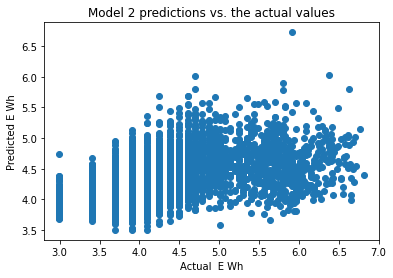

In [61]:
plt.scatter(y_test,y_pred2)
plt.title("Model 2 predictions vs. the actual values")
plt.xlabel('Actual  E Wh')
plt.ylabel('Predicted E Wh');

In [68]:
def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())

In [69]:
matches = pd.DataFrame(y_test)
matches.rename(columns = {'Actual  E Wh':'actual'}, inplace=True)
matches["predicted"] = y_pred2

In [70]:
rmse(matches["actual"], matches["predicted"])

KeyError: 'actual'

**Model 3** OLS with & Removing the variables with large p_values

In [62]:
y = df[['Appliances_E_Wh']]

X = df.drop(["Appliances_E_Wh", "date", "T_Kitchen", "H_Office", "T_Bathroom", "H_Ironing", "Tdewpoint", "H_out"],axis=1)  # Removing the variables with large p_values

In [63]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 123)

In [64]:
X = sm.add_constant(X)
rModel3 = sm.OLS(y_train, X_train)
rModel3_results = rModel3.fit() 
rModel3_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:        Appliances_E_Wh   R-squared (uncentered):                   0.983
Model:                            OLS   Adj. R-squared (uncentered):              0.983
Method:                 Least Squares   F-statistic:                          4.293e+04
Date:                Thu, 10 Mar 2022   Prob (F-statistic):                        0.00
Time:                        17:46:08   Log-Likelihood:                         -11636.
No. Observations:               13814   AIC:                                  2.331e+04
Df Residuals:                   13795   BIC:                                  2.345e+04
Df Model:                          19                                                  
Covariance Type:            nonrobust                                                  
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Lights_E_Wh           0.0167      0.001     24.848      0.000       0.015       0.018
H_Kitchen             0.1056      0.004     25.377      0.000       0.097       0.114
T_Living             -0.0968      0.008    -12.091      0.000      -0.112      -0.081
H_Living             -0.0822      0.004    -19.131      0.000      -0.091      -0.074
T_Laundry             0.1669      0.007     24.914      0.000       0.154       0.180
H_Laundry             0.0310      0.005      6.841      0.000       0.022       0.040
T_Office             -0.0290      0.007     -4.339      0.000      -0.042      -0.016
H_Bathroom            0.0032      0.001      5.396      0.000       0.002       0.004
T_Building_out_NS     0.0519      0.004     12.474      0.000       0.044       0.060
H_Building_out_NS     0.0022      0.000      5.257      0.000       0.001       0.003
T_Ironning           -0.0278      0.008     -3.276      0.001      -0.044      -0.011
T_Teenager            0.1152      0.006     18.863      0.000       0.103       0.127
H_Teenager           -0.0483      0.002    -22.091      0.000      -0.053      -0.044
T_Parents            -0.1053      0.011     -9.684      0.000      -0.127      -0.084
H_Parents            -0.0175      0.003     -6.249      0.000      -0.023      -0.012
T_out                -0.0380      0.004     -8.545      0.000      -0.047      -0.029
Press_out             0.0043      0.000     29.069      0.000       0.004       0.005
Windspeed             0.0202      0.002      9.129      0.000       0.016       0.025
Visibility            0.0008      0.000      1.942      0.052    -7.6e-06       0.002
==============================================================================
Omnibus:                     3122.582   Durbin-Watson:                   1.985
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             7572.764
Skew:                           1.254   Prob(JB):                         0.00
Kurtosis:                       5.621   Cond. No.                     2.01e+03
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 2.01e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [65]:
y_pred3 = rModel3_results.predict(X_test)

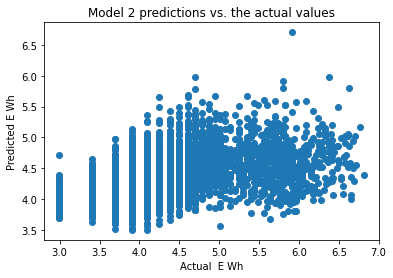

In [66]:
plt.scatter(y_test,y_pred3)
plt.title("Model 2 predictions vs. the actual values")
plt.xlabel('Actual  E Wh')
plt.ylabel('Predicted E Wh');